# **Libraries**

In [1]:
import warnings
warnings.filterwarnings('ignore')
!export CUDA_LAUNCH_BLOCKING=1

In [2]:
# We store the kaggle.json file in google drive.
from google.colab import drive
drive.mount('/content/gdrive')

import os
# Path to where the kaggle.json is stored in google drive.
os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"

Mounted at /content/gdrive


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder

In [4]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets
from torchvision import transforms

# **Data preparation**

In [5]:
!kaggle datasets download -d zalando-research/fashionmnist

 90% 62.0M/68.8M [00:00<00:00, 158MB/s]
100% 68.8M/68.8M [00:00<00:00, 198MB/s]


In [7]:
# !unzip \*.zip  && rm *.zip

Archive:  fashionmnist.zip
  inflating: fashion-mnist_test.csv  
  inflating: fashion-mnist_train.csv  
  inflating: t10k-images-idx3-ubyte  
  inflating: t10k-labels-idx1-ubyte  
  inflating: train-images-idx3-ubyte  
  inflating: train-labels-idx1-ubyte  


* We have 60K images for training and 10K for testing

## **Preprocessing Dataset**

In [8]:
class MnistFashionData(Dataset):

    # -----------------------------------------------------------------------------#

    def __init__(self, path, bs=32, cgan=True, with_normalization=True):
      """ load the dataset"""

      # read the dataframe with pandas
      self.df_train = pd.read_csv(path)
      
      # tranformations
      self.with_normalization = with_normalization
      if with_normalization :
        self.transforms = transforms.Compose([
                                      transforms.ToTensor(),
                                      transforms.Normalize( (0.5, ) , (0.5,) )
                          ])

        self.data =  self.transforms(self.prepare_train_data(self.df_train, cgan))
      else :
        # prepare the dataset, we don't need a transform to tensor, already handeled by the dataloader
        self.data =  self.prepare_train_data(self.df_train, cgan)

      # init dataloarder
      self.dataloader = DataLoader(self.data, batch_size=bs, shuffle=True) 

      # mapping between index and class. Used for plots only.
      self.labels_map = {
        0: "T-Shirt",
        1: "Trouser",
        2: "Pullover",
        3: "Dress",
        4: "Coat",
        5: "Sandal",
        6: "Shirt",
        7: "Sneaker",
        8: "Bag",
        9: "Ankle Boot",
      }

    # -----------------------------------------------------------------------------#

    # number of rows in the dataset
    def __len__(self):
        return len(self.data)

    # -----------------------------------------------------------------------------#

    # get a row at an index
    def __getitem__(self, idx):
      if self.with_normalization :
        return self.data[0][idx]
      else :
        return self.data[idx]

    # -----------------------------------------------------------------------------#

    def plot_image(self, data, index, labels=None):

      if isinstance(data, pd.core.frame.DataFrame):
        # locate the data
        row = data.iloc[index]
        # get the label
        label = self.labels_map[row[0]]
        # first position is for the label
        img_data = row[1:]
        # 784 -> 28*28 image
        dim = np.sqrt(len(row)-1).astype(np.int8)
        # transform to numpy to reshape
        img = img_data.to_numpy().reshape(dim,dim)

      elif isinstance(data, np.ndarray):    
        img_data = data[index]
        label = self.labels_map[labels[index]]
        dim = np.sqrt(len(img_data)).astype(np.int8)
        img = img_data.reshape(dim,dim)

      else :
        print("Unsupported data type for arg 1. Please use Pandas dataframe or Numpy arrays.")

      plt.title("Showing image of class : " + str(label) )
      plt.imshow(img)
      plt.show()

    # -----------------------------------------------------------------------------#

    def prepare_train_data(self, df, cgan):

      if isinstance(df, pd.core.frame.DataFrame):
        X = df.to_numpy(dtype='float64')[:, 1:]
        y = df.to_numpy(dtype='float64')[:, :1]

      else :
        X = df[:, 1:]
        y = df[:, :1]

      encoder = OneHotEncoder()
      # encode class in 1-hot vector
      y = encoder.fit_transform(y).toarray()    
      
      # stack X and y data, it contains the class label so that we learn the conditional probablity
      if cgan :
        data =  np.column_stack((X, y))
      else :
        return X
      return data

    # -----------------------------------------------------------------------------#

# **Generative modeling**

In [9]:
!nvidia-smi

Fri May 28 23:51:46 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [10]:
from torch import Tensor
import torchvision
from torchvision import transforms
import torch.nn as nn
from torch.nn import Module, BCELoss, Linear, Conv2d
from torch.nn import Softmax, ReLU, LeakyReLU, Sigmoid, Tanh
from torch.optim import SGD, Adam
from torch.nn.init import kaiming_uniform_
from torch.nn.init import xavier_uniform_

## Models definition

In [11]:
class Generator(nn.Module):
  # -----------------------------------------------------------------------------#

  # 28*28 = 784
  def __init__(self, n_inputs=128, img_dim=784, n_classes=10, alpha_relu=0.15, cgan=True):
    """ 
    The discriminator is in an decoder shape, we start by a small lattent vector for which we increase the dimensions to the desired image dimension.
    """
    super(Generator, self).__init__()

    # conditional GAN - we input also the 10-dim vector of the class of the object
    if cgan :
      n_inputs = n_inputs + n_classes

    self.linear1 = Linear(n_inputs, 256)
    self.activation1 = LeakyReLU(alpha_relu)

    self.linear2 = Linear(256, 128)
    self.activation2 = LeakyReLU(alpha_relu)

    self.linear3 = Linear(128, 64)
    self.activation3 = LeakyReLU(alpha_relu)

    self.linear4 = Linear(64, 128)
    self.activation4 = LeakyReLU(alpha_relu)

    self.linear5 = Linear(128, 256)
    self.activation5 = LeakyReLU(alpha_relu)

    self.linear6 = Linear(256, 512)
    self.activation6 = LeakyReLU(alpha_relu)

    if cgan :
      out_dim = img_dim + n_classes
    else :
      out_dim = img_dim
    self.linear7 = Linear(512, out_dim)
    self.activation7 = ReLU()

  # -----------------------------------------------------------------------------#

  def forward(self, x) :

    x = self.linear1(x)
    x = self.activation1(x)

    x = self.linear2(x)
    x = self.activation2(x)

    x = self.linear3(x)
    x = self.activation3(x)

    x = self.linear4(x)
    x = self.activation4(x)

    x = self.linear5(x)
    x = self.activation5(x)

    x = self.linear6(x)
    x = self.activation6(x)

    x = self.linear7(x)
    x = self.activation7(x)    

    return x
  # -----------------------------------------------------------------------------#
  

In [12]:
class Discriminator(nn.Module):
  # -----------------------------------------------------------------------------#

  # 28*28 = 784
  def __init__(self, n_inputs=784, n_classes=10, n_output=1, alpha_relu=0.15, cgan=True):
    """
    The discriminator is in an encoder shape, we encode the features to a smaller space of features and do the decisions.
    """
    super(Discriminator, self).__init__()
    
    # conditional GAN - we input also the 10-dim vector of the class of the object
    if cgan :
      n_inputs = n_inputs + n_classes

    self.linear1 = Linear(n_inputs, 512)
    self.activation1 = LeakyReLU(alpha_relu)

    self.linear2 = Linear(512, 256)
    self.activation2 = LeakyReLU(alpha_relu)

    self.linear3 = Linear(256, 128)
    self.activation3 = LeakyReLU(alpha_relu)

    self.linear4 = Linear(128, 64)
    self.activation4 = LeakyReLU(alpha_relu)

    self.linear5 = Linear(64, 32)
    self.activation5 = LeakyReLU(alpha_relu)

    self.linear6 = Linear(32, n_output)
    self.activation6 = Sigmoid()

  # -----------------------------------------------------------------------------#

  def forward(self, x) :

    x = self.linear1(x)
    x = self.activation1(x)

    x = self.linear2(x)
    x = self.activation2(x)

    x = self.linear3(x)
    x = self.activation3(x)

    x = self.linear4(x)
    x = self.activation4(x)

    x = self.linear5(x)
    x = self.activation5(x)

    x = self.linear6(x)
    x = self.activation6(x)

    return x
  # -----------------------------------------------------------------------------#
  

## **Hyperparameters**

In [13]:
class Hyperparameters():
  
  def __init__(self, lr=0.00002, batch_size=32, n_epochs=50, latent_dim=128, img_dim=784, n_output_disc=1, n_classes=10, alpha_relu=0.15, cgan=True):

    self.device = "cuda" if torch.cuda.is_available() else "cpu"
    self.lr = lr
    self.batch_size = batch_size
    self.n_epochs = n_epochs
    self.latent_dim = latent_dim
    # for the conditional GAN we include he one hot vector
    if cgan :
      self.input_dim_gen = latent_dim + n_classes
    else :
      self.input_dim_gen = latent_dim

    self.img_dim=img_dim
    self.n_output_disc = n_output_disc
    self.n_classes = n_classes
    self.alpha_relu=alpha_relu

## **Optimizers and Loss function**

In [14]:
from torch.utils.tensorboard import SummaryWriter

In [24]:
class Optimization():
  
  def __init__(self, gen, disc, hyperparams, cgan=True, ):

    self.generator = gen
    self.discriminator = disc
    # we use Adam optimizer for both Generator and Discriminator
    # self.opt_gen = Adam(self.generator.parameters(), lr=hyperparams.lr)
    # self.opt_disc = Adam(self.discriminator.parameters(), lr=hyperparams.lr)
    self.hyperparams = hyperparams
    self.criterion = nn.BCELoss()
    self.cgan = cgan

  def plot_image(self, data):
    
    data = data[0][:784].detach().cpu()
    dim = np.sqrt(len(data)).astype(np.int8)
    img = data.reshape(dim,dim)

    plt.imshow(img)
    plt.show()

  def train(self, dataloader, steps_train_disc=1, experiment="exp_name"):
    step = 0

    fixed_noise_vect = torch.randn(self.hyperparams.batch_size, self.hyperparams.latent_dim).to(self.hyperparams.device)
    if cgan :
      fixed_y_fake = torch.eye(self.hyperparams.n_classes)[np.argmax(torch.randn((self.hyperparams.batch_size, self.hyperparams.n_classes)) , axis=1)].to(self.hyperparams.device)
      fixed_noise_vect = torch.column_stack((fixed_noise_vect, fixed_y_fake))
    
    opt_gen = Adam(self.generator.parameters(), lr=hyperparams.lr)
    opt_disc = Adam(self.discriminator.parameters(), lr=hyperparams.lr)

    tb_writer_fake = SummaryWriter(f"logs/Mnist_fashion_GAN/fake_{experiment}")
    tb_writer_real = SummaryWriter(f"logs/Mnist_fashion_GAN/real_{experiment}")
    tb_writer_loss = SummaryWriter(f"logs/Mnist_fashion_GAN/loss_train_{experiment}")


    if self.cgan :
      print("[INFO] Started training a Conditional GAN on the MNIST Fashion dataset...")
    else :
      print("[INFO] Started training a GAN on the MNIST Fashion dataset...")

    for epoch in range(hyperparams.n_epochs):
      print("epoch = ",epoch," --------------------------------------------------------")

      for batch_idx, real_data in enumerate(dataloader) :
        
        if self.cgan :
          real_data = real_data.view(-1, 794).to(self.hyperparams.device)
        else :
          real_data = real_data.view(-1, 784).to(self.hyperparams.device)

        batch_size = real_data.shape[0]

        ##########################################
        #### Launch training of Discriminator ####
        ##########################################

        for i in range(steps_train_disc):

          # we generate an image from a noise vector
          noise = torch.randn(self.hyperparams.batch_size, self.hyperparams.latent_dim).to(self.hyperparams.device)
          if cgan :
            y_fake = torch.eye(self.hyperparams.n_classes)[np.argmax(torch.randn((self.hyperparams.batch_size, self.hyperparams.n_classes)) , axis=1)].to(self.hyperparams.device)
            noise = torch.column_stack((noise, y_fake))

          # noise = torch.randn(batch_size, self.hyperparams.input_dim_gen).to(self.hyperparams.device)
          fake_data = self.generator(noise)

          # prediction of the discriminator on real an fake images in the batch
          disc_real = self.discriminator(real_data.float()).view(-1)
          disc_fake = self.discriminator(fake_data.float()).view(-1)

          # the loss on the real image in the batch
          loss_D_real = self.criterion(disc_real, torch.ones_like(disc_real))
          # the loss on the fake image in the batch
          loss_D_fake = self.criterion(disc_fake, torch.zeros_like(disc_fake))
          # total discriminator loss          
          loss_D = (loss_D_real + loss_D_fake) / 2

          # run backprop
          opt_disc.zero_grad()
          loss_D.backward()
          opt_disc.step()

        ##########################################
        #####  Launch training of Generator   ####
        ##########################################

        # we want to min log(1 - D(G(z))) which is equivalent to max log(D(G(z))) and it's better in the begining of the training (better gradients).
        fake_data = self.generator(noise)
        disc_pred = self.discriminator(fake_data.float()).view(-1)
        loss_G = self.criterion(disc_pred, torch.ones_like(disc_pred))

        # run backprop
        opt_gen.zero_grad()
        loss_G.backward()
        opt_gen.step()

      # state after this epoch
      with torch.no_grad():
        fake_data_ = self.generator(fixed_noise_vect)
        # self.plot_image(fake_data_)
        fake_data_ = fake_data_[:, :784].reshape(-1, 1, 28, 28)
        real_data_ = real_data[:, :784].reshape(-1, 1, 28, 28)

        img_fake = torchvision.utils.make_grid(fake_data_, normalize=True)
        img_real = torchvision.utils.make_grid(real_data_, normalize=True)

        # Adding generated images to tb
        tb_writer_loss.add_scalar(
            "loss_D", loss_D, global_step=step
        )

        tb_writer_loss.add_scalar(
            "loss_G", loss_G, global_step=step
        )
         
        # Adding generated images to tb
        tb_writer_fake.add_image(
            "Fake images", img_fake, global_step=step
        )

        tb_writer_real.add_image(
            "Real images", img_real, global_step=step
        )

        step = step + 1 

        print(
            f"Epoch [{epoch}/{hyperparams.n_epochs}] \ "
            f"Loss_D : [{loss_D:.4f}] \ "
            f"loss_G : [{loss_G:.4f}] \ "
        )

## **Initializing Generator and Discriminator**

# **Conditional GAN**

In [36]:
cgan=True
with_normalization=False

mnist_data = MnistFashionData(path="./fashion-mnist_train.csv", cgan=cgan, with_normalization=with_normalization)

In [37]:
print(mnist_data.data.shape)
print(mnist_data.data[0].shape)
print(next(iter(mnist_data.dataloader)).shape)
# contains the class label so that we learn the conditional probablity
print(mnist_data.data.shape)

(60000, 794)
(794,)
torch.Size([32, 794])
(60000, 794)


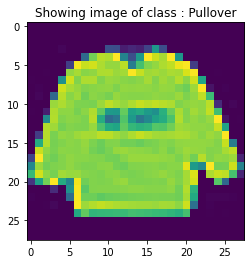

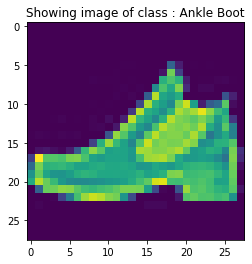

In [38]:
for index in range(2) :
  mnist_data.plot_image(mnist_data.df_train, index)

In [39]:
latent_dim = 128
n_epochs = 400
hyperparams = Hyperparameters(n_epochs=n_epochs, cgan=cgan, latent_dim=latent_dim, lr=1e-03)
fixed_noise_vect = torch.randn((hyperparams.batch_size,hyperparams.input_dim_gen)).to(hyperparams.device)

In [40]:
print(hyperparams.input_dim_gen)
print(hyperparams.lr)

138
0.001


In [41]:
print(fixed_noise_vect)
print("Shape of fixed noise vector : ", fixed_noise_vect.shape)

tensor([[-0.1875,  0.2308, -1.6689,  ...,  1.1130, -0.4648, -0.2602],
        [ 1.6721, -1.6602,  0.6437,  ..., -0.4371,  0.7160, -0.1225],
        [ 0.5413, -0.2416,  1.3957,  ...,  0.5764, -0.9319, -1.5357],
        ...,
        [ 0.0896, -0.6063, -1.2211,  ..., -0.7595,  0.4903, -1.6769],
        [-0.4263,  1.8367, -0.6446,  ...,  2.4181, -0.4683,  0.9112],
        [ 0.9501,  0.1740,  0.4315,  ...,  0.6993,  0.2667, -0.8862]],
       device='cuda:0')
Shape of fixed noise vector :  torch.Size([32, 138])


In [42]:
disc = Discriminator(cgan=cgan, n_inputs=hyperparams.img_dim, n_classes=hyperparams.n_classes, n_output=hyperparams.n_output_disc, alpha_relu=hyperparams.alpha_relu).to(hyperparams.device)
gen = Generator(cgan=cgan, n_inputs=hyperparams.latent_dim, img_dim=hyperparams.img_dim, n_classes=hyperparams.n_classes, alpha_relu=hyperparams.alpha_relu).to(hyperparams.device)

In [43]:
gen

Generator(
  (linear1): Linear(in_features=138, out_features=256, bias=True)
  (activation1): LeakyReLU(negative_slope=0.15)
  (linear2): Linear(in_features=256, out_features=128, bias=True)
  (activation2): LeakyReLU(negative_slope=0.15)
  (linear3): Linear(in_features=128, out_features=64, bias=True)
  (activation3): LeakyReLU(negative_slope=0.15)
  (linear4): Linear(in_features=64, out_features=128, bias=True)
  (activation4): LeakyReLU(negative_slope=0.15)
  (linear5): Linear(in_features=128, out_features=256, bias=True)
  (activation5): LeakyReLU(negative_slope=0.15)
  (linear6): Linear(in_features=256, out_features=512, bias=True)
  (activation6): LeakyReLU(negative_slope=0.15)
  (linear7): Linear(in_features=512, out_features=794, bias=True)
  (activation7): ReLU()
)

In [44]:
disc

Discriminator(
  (linear1): Linear(in_features=794, out_features=256, bias=True)
  (activation1): LeakyReLU(negative_slope=0.15)
  (linear2): Linear(in_features=256, out_features=128, bias=True)
  (activation2): LeakyReLU(negative_slope=0.15)
  (linear3): Linear(in_features=128, out_features=64, bias=True)
  (activation3): LeakyReLU(negative_slope=0.15)
  (linear4): Linear(in_features=64, out_features=32, bias=True)
  (activation4): LeakyReLU(negative_slope=0.15)
  (linear5): Linear(in_features=32, out_features=1, bias=True)
  (activation5): Sigmoid()
)

## **Training the models in adversarial framework**

In [45]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
%tensorboard --logdir logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 149), started 1:40:23 ago. (Use '!kill 149' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
optimization = Optimization(gen, disc, hyperparams, cgan)
optimization.train(mnist_data.dataloader)

[INFO] Started training a Conditional GAN on the MNIST Fashion dataset...
epoch =  0  --------------------------------------------------------
Epoch [0/400] \ Loss_D : [0.6502] \ loss_G : [0.7410] \ 
epoch =  1  --------------------------------------------------------
Epoch [1/400] \ Loss_D : [0.6049] \ loss_G : [1.3366] \ 
epoch =  2  --------------------------------------------------------
Epoch [2/400] \ Loss_D : [0.6213] \ loss_G : [0.7705] \ 
epoch =  3  --------------------------------------------------------
Epoch [3/400] \ Loss_D : [0.6406] \ loss_G : [0.8395] \ 
epoch =  4  --------------------------------------------------------
Epoch [4/400] \ Loss_D : [0.5171] \ loss_G : [1.2732] \ 
epoch =  5  --------------------------------------------------------
Epoch [5/400] \ Loss_D : [0.5401] \ loss_G : [0.9656] \ 
epoch =  6  --------------------------------------------------------
Epoch [6/400] \ Loss_D : [0.6007] \ loss_G : [1.0068] \ 
epoch =  7  --------------------------------

In [47]:
# !rm -vrf ./logs

# **Vanilla GAN**

In [28]:
cgan=False
with_normalization=False

mnist_data = MnistFashionData(path="./fashion-mnist_train.csv", cgan=cgan, with_normalization=with_normalization)

In [29]:
latent_dim = 64
n_epochs = 1000
hyperparams = Hyperparameters(n_epochs=n_epochs, cgan=cgan, latent_dim=latent_dim, lr=1e-04)
fixed_noise_vect = torch.randn((hyperparams.batch_size,hyperparams.input_dim_gen)).to(hyperparams.device)

In [30]:
print(hyperparams.input_dim_gen)
print(hyperparams.lr)
print(hyperparams.device)
print(fixed_noise_vect.shape)

64
0.0001
cuda
torch.Size([32, 64])


In [31]:
disc = Discriminator(cgan=cgan, n_inputs=hyperparams.img_dim, n_classes=hyperparams.n_classes, n_output=hyperparams.n_output_disc, alpha_relu=hyperparams.alpha_relu).to(hyperparams.device)
gen = Generator(cgan=cgan, n_inputs=hyperparams.latent_dim, img_dim=hyperparams.img_dim, n_classes=hyperparams.n_classes, alpha_relu=hyperparams.alpha_relu).to(hyperparams.device)

In [32]:
gen

Generator(
  (linear1): Linear(in_features=64, out_features=256, bias=True)
  (activation1): LeakyReLU(negative_slope=0.15)
  (linear2): Linear(in_features=256, out_features=128, bias=True)
  (activation2): LeakyReLU(negative_slope=0.15)
  (linear3): Linear(in_features=128, out_features=64, bias=True)
  (activation3): LeakyReLU(negative_slope=0.15)
  (linear4): Linear(in_features=64, out_features=128, bias=True)
  (activation4): LeakyReLU(negative_slope=0.15)
  (linear5): Linear(in_features=128, out_features=256, bias=True)
  (activation5): LeakyReLU(negative_slope=0.15)
  (linear6): Linear(in_features=256, out_features=512, bias=True)
  (activation6): LeakyReLU(negative_slope=0.15)
  (linear7): Linear(in_features=512, out_features=784, bias=True)
  (activation7): ReLU()
)

In [33]:
disc

Discriminator(
  (linear1): Linear(in_features=784, out_features=512, bias=True)
  (activation1): LeakyReLU(negative_slope=0.15)
  (linear2): Linear(in_features=512, out_features=256, bias=True)
  (activation2): LeakyReLU(negative_slope=0.15)
  (linear3): Linear(in_features=256, out_features=128, bias=True)
  (activation3): LeakyReLU(negative_slope=0.15)
  (linear4): Linear(in_features=128, out_features=64, bias=True)
  (activation4): LeakyReLU(negative_slope=0.15)
  (linear5): Linear(in_features=64, out_features=32, bias=True)
  (activation5): LeakyReLU(negative_slope=0.15)
  (linear6): Linear(in_features=32, out_features=1, bias=True)
  (activation6): Sigmoid()
)

## **Training the models in adversarial framework**

In [34]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
%tensorboard --logdir logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
optimization = Optimization(gen, disc, hyperparams, cgan)
optimization.train(mnist_data.dataloader, experiment="vanilla")

[INFO] Started training a GAN on the MNIST Fashion dataset...
epoch =  0  --------------------------------------------------------
Epoch [0/1000] \ Loss_D : [0.0194] \ loss_G : [3.7565] \ 
epoch =  1  --------------------------------------------------------
Epoch [1/1000] \ Loss_D : [0.2198] \ loss_G : [8.3867] \ 
epoch =  2  --------------------------------------------------------
Epoch [2/1000] \ Loss_D : [0.0092] \ loss_G : [5.6886] \ 
epoch =  3  --------------------------------------------------------
Epoch [3/1000] \ Loss_D : [0.0053] \ loss_G : [8.2576] \ 
epoch =  4  --------------------------------------------------------
Epoch [4/1000] \ Loss_D : [0.0010] \ loss_G : [7.0477] \ 
epoch =  5  --------------------------------------------------------
Epoch [5/1000] \ Loss_D : [0.0003] \ loss_G : [7.7636] \ 
epoch =  6  --------------------------------------------------------
Epoch [6/1000] \ Loss_D : [0.0001] \ loss_G : [12.4796] \ 
epoch =  7  ------------------------------------

In [27]:
# !rm -vrf ./logs

removed './logs/Mnist_fashion_GAN/fake_vanilla/events.out.tfevents.1622245959.ef859ead56f8.59.0'
removed './logs/Mnist_fashion_GAN/fake_vanilla/events.out.tfevents.1622246045.ef859ead56f8.59.3'
removed directory './logs/Mnist_fashion_GAN/fake_vanilla'
removed './logs/Mnist_fashion_GAN/loss_train_vanilla/events.out.tfevents.1622246045.ef859ead56f8.59.5'
removed './logs/Mnist_fashion_GAN/loss_train_vanilla/events.out.tfevents.1622245959.ef859ead56f8.59.2'
removed directory './logs/Mnist_fashion_GAN/loss_train_vanilla'
removed './logs/Mnist_fashion_GAN/real_vanilla/events.out.tfevents.1622246045.ef859ead56f8.59.4'
removed './logs/Mnist_fashion_GAN/real_vanilla/events.out.tfevents.1622245959.ef859ead56f8.59.1'
removed directory './logs/Mnist_fashion_GAN/real_vanilla'
removed directory './logs/Mnist_fashion_GAN'
removed directory './logs'


In [111]:
cgan

False